<a href="https://colab.research.google.com/github/PranayLendave/video_classification/blob/main/trained_movinets_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
%cd /content/
!mkdir video_classification
%cd video_classification

[Errno 2] No such file or directory: '/content/'
/kaggle/working
/kaggle/working/video_classification


In [3]:

!conda install -y gdown
!gdown --id 1CjgOI-O9uCgczS2Hdm3I520HzlMCCn05
! unzip /kaggle/working/video_classification/UCF_50_Split.zip

Retrieving notices: ...working... done
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 23.7.3
  latest version: 23.9.0

Please update conda by running

    $ conda update -n base -c conda-forge conda

Or to minimize the number of packages updated during conda update use

     conda install conda=23.9.0



## Package Plan ##

  environment location: /opt/conda

  added / updated specs:
    - gdown


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    filelock-3.13.1            |     pyhd8ed1ab_0          15 KB  conda-forge
    gdown-4.7.1                |     pyhd8ed1ab_0          19 KB  conda-forge
    openssl-3.1.4              |       hd590300_0         2.5 MB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.6 MB

The following NEW packages will be INSTA

## Video Classification

This notebook provides basic example code to build, run, and fine-tune [MoViNets (Mobile Video Networks)](https://arxiv.org/pdf/2103.11511.pdf).

Pretrained models are provided by [TensorFlow Hub](https://tfhub.dev/google/collections/movinet/) and the [TensorFlow Model Garden](https://github.com/tensorflow/models/tree/master/official/projects/movinet), trained on [UCF101](https://www.crcv.ucf.edu/data/UCF101.php) for video action classification. All Models use TensorFlow 2 with Keras for inference and training.

The following steps will be performed:

1. [Installation](#scrollTo=dPx7Pp7fbgLY&uniqifier=1)
2. [Download a subset of the UCF101 dataset](#scrollTo=KbhwWLLM7FXo&uniqifier=1)
3. [Download a pre-trained MoViNet model](#scrollTo=aYYShfhMx9DW&uniqifier=1)
4. [Save and load model](#scrollTo=YDk6LAciJfnA&uniqifier=1)
5. [Evaluate the model](#scrollTo=KkLl2zF8G9W0&uniqifier=1)
6. [Inferencing using the trained model on GIF](#scrollTo=6s9Q_JBcVmN1&uniqifier=1)

**Note: Enabling GPU Acceleration**

To utilize GPU acceleration in Colab, follow these steps:

1. Click on the "Runtime" menu at the top.
2. Select "Change runtime type" from the dropdown menu.
3. In the dialog box, choose "GPU" as the hardware accelerator.
4. Click on the "Save" button.

Enabling GPU will allow you to take advantage of faster computation for deep learning tasks.










## Installation



Install Dependencies: Run the following code block to install the necessary dependencies, including remotezip, tqdm, opencv-python, tf-models-official, and other required packages.

In [3]:
#%%capture
!pip install remotezip tqdm opencv-python==4.5.2.52 opencv-python-headless==4.5.2.52 tf-models-official
!pip install remotezip
!pip install tf-models-official
!pip install -q mediapy


  Preparing metadata (setup.py) ... done
ERROR: Could not find a version that satisfies the requirement opencv-python==4.5.2.52 (from versions: 3.4.0.14, 3.4.10.37, 3.4.11.39, 3.4.11.41, 3.4.11.43, 3.4.11.45, 3.4.13.47, 3.4.15.55, 3.4.16.57, 3.4.16.59, 3.4.17.61, 3.4.17.63, 3.4.18.65, 4.3.0.38, 4.4.0.40, 4.4.0.42, 4.4.0.44, 4.4.0.46, 4.5.1.48, 4.5.3.56, 4.5.4.58, 4.5.4.60, 4.5.5.62, 4.5.5.64, 4.6.0.66, 4.7.0.68, 4.7.0.72, 4.8.0.74, 4.8.0.76, 4.8.1.78)
ERROR: No matching distribution found for opencv-python==4.5.2.52
  Using cached remotezip-0.12.1.tar.gz (7.5 kB)
  Preparing metadata (setup.py) ... done
  Created wheel for remotezip: filename=remotezip-0.12.1-py3-none-any.whl size=7933 sha256=7d3a7d75b6a7f0eb1267b8cf27ca9755dfb6c349ab80f2ade4924cd18178966c
  Stored in directory: /root/.cache/pip/wheels/fc/76/04/beed1a6df4eb7430ee13c3900746edd517e5e597298d1f73f3
Successfully built remotezip
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 25.7 MB/s eta 0:00:00a 0:00:01
     ━━━━

Import Libraries: Make sure to import the essential libraries for video processing, data manipulation, visualization, and deep learning operations. Include the following modules in your code:

**NOTE!!**: Below code might give you an error but running it again would solve the issue

In [5]:
import tqdm
import random
import pathlib
import itertools
import collections
import os

import cv2
import numpy as np
import remotezip as rz
import seaborn as sns
import matplotlib.pyplot as plt

import keras
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Import the MoViNet model from TensorFlow Models (tf-models-official) for the MoViNet model
from official.projects.movinet.modeling import movinet
from official.projects.movinet.modeling import movinet_model

import mediapy as media


2023-11-03 18:05:25.495172: E tensorflow/tsl/lib/monitoring/collection_registry.cc:81] Cannot register 2 metrics with the same name: /tensorflow/api/enable_tensor_equality


AlreadyExistsError: Another metric with the same name already exists.

With these installation and import steps completed, you are now ready to leverage the power of MoViNet for accurate video classification.

Feel free to customize the installation and import instructions based on your specific needs.

## Download a subset of the UCF101 dataset

The [UCF101 dataset](https://www.tensorflow.org/datasets/catalog/ucf101) contains 101 categories of different actions in video, primarily used in action recognition. You will use a subset of these categories in this demo.

These helper functions collectively assist in various stages of video processing, model loading, classification, and result visualization. They enhance the functionality and usability of the code by encapsulating specific tasks and making the code more modular and organized.

In [7]:
#@title

def get_class(fname):
  """ Retrieve the name of the class given a filename.

    Args:
      fname: Name of the file in the UCF101 dataset.

    Returns:
      Class that the file belongs to.
  """
  return fname.split('_')[-3]


def list_files_per_class(zip_url):
  """
    List the files in each class of the dataset given the zip URL.

    Args:
      zip_url: URL from which the files can be unzipped.

    Return:
      files: List of files in each of the classes.
  """
  files = []
  with rz.RemoteZip(URL) as zip:
    for zip_info in zip.infolist():
      files.append(zip_info.filename)
  return files

def get_class(fname):
  """
    Retrieve the name of the class given a filename.

    Args:
      fname: Name of the file in the UCF101 dataset.

    Return:
      Class that the file belongs to.
  """
  return fname.split('_')[-3]

def get_files_per_class(files):
  """
    Retrieve the files that belong to each class.

    Args:
      files: List of files in the dataset.

    Return:
      Dictionary of class names (key) and files (values).
  """
  files_for_class = collections.defaultdict(list)
  for fname in files:
    class_name = get_class(fname)
    files_for_class[class_name].append(fname)
  return files_for_class

def select_subset_of_classes(files_for_class, classes, files_per_class):
  """ Create a dictionary with the class name and a subset of the files in that class.

    Args:
      files_for_class: Dictionary of class names (key) and files (values).
      classes: List of classes.
      files_per_class: Number of files per class of interest.

    Returns:
      Dictionary with class as key and list of specified number of video files in that class.
  """
  files_subset = dict()

  for class_name in classes:
    class_files = files_for_class[class_name]
    files_subset[class_name] = class_files[:files_per_class]

  return files_subset

def download_from_zip(zip_url, to_dir, file_names):
  """ Download the contents of the zip file from the zip URL.

    Args:
      zip_url: A URL with a zip file containing data.
      to_dir: A directory to download data to.
      file_names: Names of files to download.
  """
  with rz.RemoteZip(zip_url) as zip:
    for fn in tqdm.tqdm(file_names):
      class_name = get_class(fn)
      zip.extract(fn, str(to_dir / class_name))
      unzipped_file = to_dir / class_name / fn

      fn = pathlib.Path(fn).parts[-1]
      output_file = to_dir / class_name / fn
      unzipped_file.rename(output_file)

def split_class_lists(files_for_class, count):
  """
    Returns the list of files belonging to a subset of data as well as the remainder of
    files that need to be downloaded.

    Args:
      files_for_class: Files belonging to a particular class of data.
      count: Number of files to download.

    Return:
      split_files: Files belonging to the subset of data.
      remainder: Dictionary of the remainder of files that need to be downloaded.
  """
  split_files = []
  remainder = {}
  for cls in files_for_class:
    split_files.extend(files_for_class[cls][:count])
    remainder[cls] = files_for_class[cls][count:]
  return split_files, remainder

def download_ucf_101_subset(zip_url, num_classes, splits, download_dir,classes_1):
  """ Download a subset of the UCF101 dataset and split them into various parts, such as
    training, validation, and test.

    Args:
      zip_url: A URL with a ZIP file with the data.
      num_classes: Number of labels.
      splits: Dictionary specifying the training, validation, test, etc. (key) division of data
              (value is number of files per split).
      download_dir: Directory to download data to.

    Return:
      Mapping of the directories containing the subsections of data.
  """
  files = list_files_from_zip_url(zip_url)
  for f in files:
    path = os.path.normpath(f)
    tokens = path.split(os.sep)
    if len(tokens) <= 2:
      files.remove(f) # Remove that item from the list if it does not have a filename

  files_for_class = get_files_per_class(files)

  # classes = list(files_for_class.keys())[:num_classes]
  classes = classes_1

  for cls in classes:
    random.shuffle(files_for_class[cls])

  # Only use the number of classes you want in the dictionary
  files_for_class = {x: files_for_class[x] for x in classes}

  dirs = {}
  for split_name, split_count in splits.items():
    print(split_name, ":")
    split_dir = download_dir / split_name
    split_files, files_for_class = split_class_lists(files_for_class, split_count)
    download_from_zip(zip_url, split_dir, split_files)
    dirs[split_name] = split_dir

  return dirs



In [7]:
def format_frames(frame, output_size):
  """
    Pad and resize an image from a video.

    Args:
      frame: Image that needs to resized and padded.
      output_size: Pixel size of the output frame image.

    Return:
      Formatted frame with padding of specified output size.
  """
    
  frame = tf.image.convert_image_dtype(frame, tf.float32)
  frame = tf.image.resize_with_pad(frame, *output_size)
  return frame

def frames_from_video_file(video_path, n_frames, output_size = (224,224), frame_step = 15):
  """
    Creates frames from each video file present for each category.

    Args:
      video_path: File path to the video.
      n_frames: Number of frames to be created per video file.
      output_size: Pixel size of the output frame image.

    Return:
      An NumPy array of frames in the shape of (n_frames, height, width, channels).
  """
  # Read each video frame by frame
  result = []
  src = cv2.VideoCapture(str(video_path))

  video_length = src.get(cv2.CAP_PROP_FRAME_COUNT)

  need_length = 1 + (n_frames - 1) * frame_step

  if need_length > video_length:
    start = 0
  else:
    max_start = video_length - need_length
    start = random.randint(0, max_start + 1)

  src.set(cv2.CAP_PROP_POS_FRAMES, start)
  # ret is a boolean indicating whether read was successful, frame is the image itself
  ret, frame = src.read()
  result.append(format_frames(frame, output_size))

  for _ in range(n_frames - 1):
    for _ in range(frame_step):
      ret, frame = src.read()
    if ret:
      frame = format_frames(frame, output_size)
      result.append(frame)
    else:
      result.append(np.zeros_like(result[0]))
  src.release()
  result = np.array(result)[..., [2, 1, 0]]

  return result

def list_files_from_zip_url(zip_url):
  """ List the files in each class of the dataset given a URL with the zip file.

    Args:
      zip_url: A URL from which the files can be extracted from.

    Returns:
      List of files in each of the classes.
  """
  files = []
  with rz.RemoteZip(zip_url) as zip:
    for zip_info in zip.infolist():
      files.append(zip_info.filename)
  return files

class FrameGenerator:
  def __init__(self, path, n_frames, training = False):
    """ Returns a set of frames with their associated label.

      Args:
        path: Video file paths.
        n_frames: Number of frames.
        training: Boolean to determine if training dataset is being created.
    """
    self.path = path
    self.n_frames = n_frames
    self.training = training
    self.class_names = sorted(set(p.name for p in self.path.iterdir() if p.is_dir()))
    self.class_ids_for_name = dict((name, idx) for idx, name in enumerate(self.class_names))

  def get_files_and_class_names(self):
    video_paths = list(self.path.glob('*/*.avi'))
    classes = [p.parent.name for p in video_paths]
    return video_paths, classes

  def __call__(self):
    video_paths, classes = self.get_files_and_class_names()

    pairs = list(zip(video_paths, classes))

    if self.training:
      random.shuffle(pairs)

    for path, name in pairs:
      video_frames = frames_from_video_file(path, self.n_frames)
      label = self.class_ids_for_name[name] # Encode labels
      yield video_frames, label

Once you have the list of files per class, you can choose how many classes you would like to use and how many videos you would like per class in order to create your dataset.

All the classes of UCF101 dataset

These are the selected classes from the above classes list

In [8]:
classes_1 = ['BaseballPitch'
,'Basketball'
,'BenchPress'
,'Biking'
,'Billiards'
,'BreastStroke'
,'CleanAndJerk'
,'Diving'
,'Drumming'
,'Fencing'
,'GolfSwing'
,'HighJump'
,'HorseRace'
,'HorseRiding'
,'HulaHoop'
,'JavelinThrow'
,'JugglingBalls'
,'JumpRope'
,'JumpingJack'
,'Kayaking'
,'Lunges'
,'MilitaryParade'
,'Mixing'
,'Nunchucks'
,'PizzaTossing'
,'PlayingGuitar'
,'PlayingPiano'
,'PlayingTabla'
,'PlayingViolin'
,'PoleVault'
,'PommelHorse'
,'PullUps'
,'Punch'
,'PushUps'
,'RockClimbingIndoor'
,'RopeClimbing'
,'Rowing'
,'SalsaSpin'
,'SkateBoarding'
,'Skiing'
,'Skijet'
,'SoccerJuggling'
,'Swing'
,'TaiChi'
,'TennisSwing'
,'ThrowDiscus'
,'TrampolineJumping'
,'VolleyballSpiking'
,'WalkingWithDog'
,'YoYo']


NUM_CLASSES = len(classes_1)
print(NUM_CLASSES)


50


The following function returns the remaining data that hasn't already been placed into a subset of data. It allows you to place that remaining data in the next specified subset of data.

## Create the training and test datasets

In [9]:
batch_size = 64
num_frames = 10

output_signature = (tf.TensorSpec(shape = (None, None, None, 3), dtype = tf.float32),
                    tf.TensorSpec(shape = (), dtype = tf.int16))

train_ds = tf.data.Dataset.from_generator(FrameGenerator(pathlib.Path('/kaggle/working/video_classification/UCF_50_Split/train'), num_frames, training = True),
                                          output_signature = output_signature)
train_ds = train_ds.batch(batch_size)

test_ds = tf.data.Dataset.from_generator(FrameGenerator(pathlib.Path('/kaggle/working/video_classification/UCF_50_Split/val'), num_frames),
                                         output_signature = output_signature)
test_ds = test_ds.batch(batch_size)
'''
val_ds = tf.data.Dataset.from_generator(FrameGenerator(subset_paths['val'], num_frames),
                                          output_signature = output_signature)
val_ds = val_ds.batch(batch_size)
'''

"\nval_ds = tf.data.Dataset.from_generator(FrameGenerator(subset_paths['val'], num_frames),\n                                          output_signature = output_signature)\nval_ds = val_ds.batch(batch_size)\n"

The labels generated here represent the encoding of the classes. For instance, 'ApplyEyeMakeup' is mapped to the integer Take a look at the labels of the training data to ensure that the dataset has been sufficiently shuffled.

In [10]:
for frames, labels in train_ds.take(NUM_CLASSES):
  print(labels)

tf.Tensor(
[ 7  4 38  9 20 48  4 19 40 18 46 37  8 39 20 46 28  1 45 14  2 35 32 15
  8 30 41 19  5  7  0 13 32 38 11 42 12  7 40  8 44 33 34 24 10 46 13 32
  7 19 39 39 16 39 23 42 34 47 36 41 42 29  7 42], shape=(64,), dtype=int16)
tf.Tensor(
[35 40 18  3 34 10 34  4 48 21 34 40 23 10 32  3 15 41 16  3  8  7  0  4
 20 41  3 10 48 34 40 10  7 44 10 20 31 11 13 35  8 41 17  5 13  6  1  5
 41 23 24 21 14  7  3 19 29 27 31 29 42 29 22  0], shape=(64,), dtype=int16)
tf.Tensor(
[ 9 32 10 33  3  5  3  4  0 15 25 39 35 39  9 38 21 35 44 13 19 22 44  0
  2 26 32  4 40 10 38 32 49 14 15 41 29 37  8 13 21 11 39 45 19 49  9 20
 44 23  7  0  2 14  4 35 31  4 23 10 24  8 23 16], shape=(64,), dtype=int16)
tf.Tensor(
[ 0 25 26 32 36 17 33 17 20 29 33 38 37 34 42 21 26 18  3 13 12 31 36 35
 36 36 21 27 20 12 28 23 25 23 21 23 28 38 38 39 25  9 12 38  3 41 15 43
 32  7 47 15 10  7  2 46 46 41 30 20 25 42 48  0], shape=(64,), dtype=int16)
tf.Tensor(
[46 42 25 49 39 13 32 36 34  0 38 14 46 34 48 42 15 2

Take a look at the shape of the data.

In [11]:
print(f"Shape: {frames.shape}")
print(f"Label: {labels.shape}")

Shape: (64, 10, 224, 224, 3)
Label: (64,)


,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,

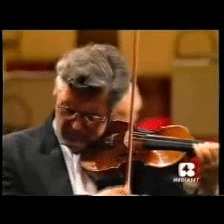
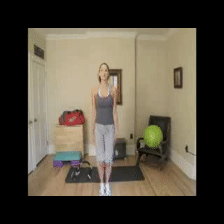
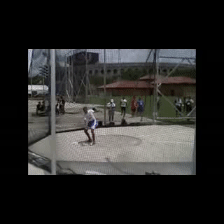
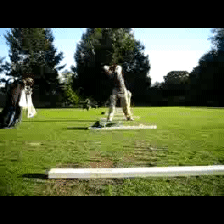
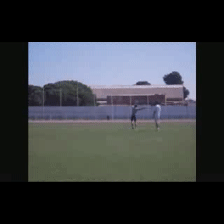
...
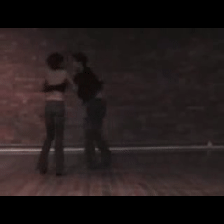
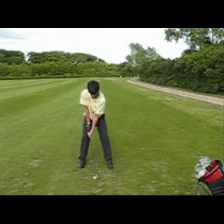
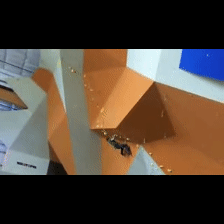
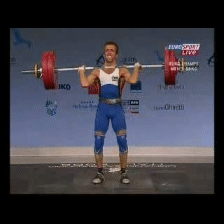
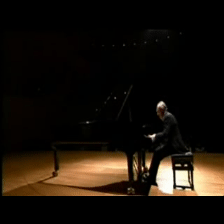

In [12]:
videos, labels = next(iter(train_ds))
media.show_videos(videos.numpy(), codec='gif', fps=10)

## Download a pre-trained MoViNet model

In this section, we will:

1. We can create a MoViNet model using the open source code provided in [`official/projects/movinet`](https://github.com/tensorflow/models/tree/master/official/projects/movinet) from TensorFlow models.
2. Load the pretrained weights.
3. Freeze the convolutional base, or all other layers except the final classifier head, to speed up fine-tuning.

To build the model, we can start with the `a0` configuration because it is the fastest to train when benchmarked against other models. Check out the [available MoViNet models on TensorFlow Model Garden](https://github.com/tensorflow/models/blob/master/official/projects/movinet/configs/movinet.py) to find what might work for our use case.

To build a classifier, create a function that takes the backbone and the number of classes in a dataset. The `build_classifier` function will take the backbone and the number of classes in a dataset to build the classifier. In this case, the new classifier will take a `num_classes` outputs (10 classes for this subset of UCF101).

In [ ]:
def build_classifier(batch_size, num_frames, resolution, backbone, num_classes):
  """Builds a classifier on top of a backbone model."""
  model = movinet_model.MovinetClassifier(
      backbone=backbone,
      num_classes=num_classes)
  model.build([batch_size, num_frames, resolution, resolution, 3])

  return model

In [ ]:
batch_size, num_frames, resolution, backbone, NUM_CLASSES

In [ ]:
model = build_classifier(batch_size, num_frames, resolution, backbone, NUM_CLASSES)

In [ ]:
model.summary()

In [6]:
model_id = 'a0'
resolution = 224
NUM_CLASSES = 50  # You can adjust this based on your dataset

import tensorflow as tf
from tensorflow.keras import layers, models, regularizers

tf.keras.backend.clear_session()

# Load the pre-trained Movinet model
backbone = movinet.Movinet(model_id=model_id)
backbone.trainable = False

# Set num_classes=600 to load the pre-trained weights from the original model
model = movinet_model.MovinetClassifier(backbone=backbone, num_classes=NUM_CLASSES)
model.build([None, None, None, None, 3])

# Load pre-trained weights
!wget https://storage.googleapis.com/tf_model_garden/vision/movinet/movinet_a0_base.tar.gz -O movinet_a0_base.tar.gz -q
!tar -xvf movinet_a0_base.tar.gz

checkpoint_dir = f'movinet_{model_id}_base'
checkpoint_path = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint = tf.train.Checkpoint(model=model)
status = checkpoint.restore(checkpoint_path)
status.assert_existing_objects_matched()

# Define the number of classes, batch size, and number of frames
batch_size = 64  # You can adjust this based on your dataset and available resources
num_frames = 10  # You can adjust this based on your dataset

# Build the classifier model with additional layers and regularization to reduce overfitting
def build_classifier(batch_size, num_frames, resolution, backbone, num_classes):
  model = movinet_model.MovinetClassifier(
      backbone=backbone,
      num_classes=num_classes)

  # Add regularization layers and dropout
  model = models.Sequential([
      model,
      layers.Dropout(0.25),  # Add dropout layer with a suitable dropout rate
      layers.Dense(512, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
      layers.Dropout(0.30),
      layers.Dense(256, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
      layers.Dropout(0.30),  # Add another dropout layer
      layers.Dense(50, activation='softmax')
  ])

  model.build([batch_size, num_frames, resolution, resolution, 3])
  return model

model = build_classifier(batch_size, num_frames, resolution, backbone, NUM_CLASSES)



NameError: name 'movinet' is not defined

For this tutorial, choose the `tf.keras.optimizers.Adam` optimizer and the `tf.keras.losses.SparseCategoricalCrossentropy` loss function. Use the metrics argument to the view the accuracy of the model performance at every step.

In [ ]:
import tensorflow as tf
from tensorflow.keras.metrics import SparseTopKCategoricalAccuracy

# Define the number of top-k classes to consider
k = 5  # You can adjust this value as needed

# Define your loss and optimizer as you've already done
loss_obj = tf.keras.losses.SparseCategoricalCrossentropy()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)

# Create a list of metrics, including top-k categorical accuracy
metrics = [
    SparseTopKCategoricalAccuracy(k=k),  # Use SparseTopKCategoricalAccuracy with k value
    'accuracy'  # Regular accuracy
]

# Compile the model with the loss, optimizer, and metrics
model.compile(loss=loss_obj, optimizer=optimizer, metrics=metrics)
# When training your model, top-k categorical accuracy will be monitored in addition to regular accuracy.


In [19]:

loss_obj = tf.keras.losses.SparseCategoricalCrossentropy()
optimizer = tf.keras.optimizers.Adam(learning_rate = 0.001)
# Compile the model with an appropriate optimizer and loss function
#model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])
model.compile(loss=loss_obj, optimizer=optimizer, metrics=['accuracy'])

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 movinet_classifier_1 (Movi  (None, 600)               3126071   
 netClassifier)                                                  
                                                                 
 dropout_2 (Dropout)         (None, 600)               0         
                                                                 
 dense (Dense)               (None, 512)               307712    
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dropout_4 (Dropout)         (None, 256)               0         
                                                        

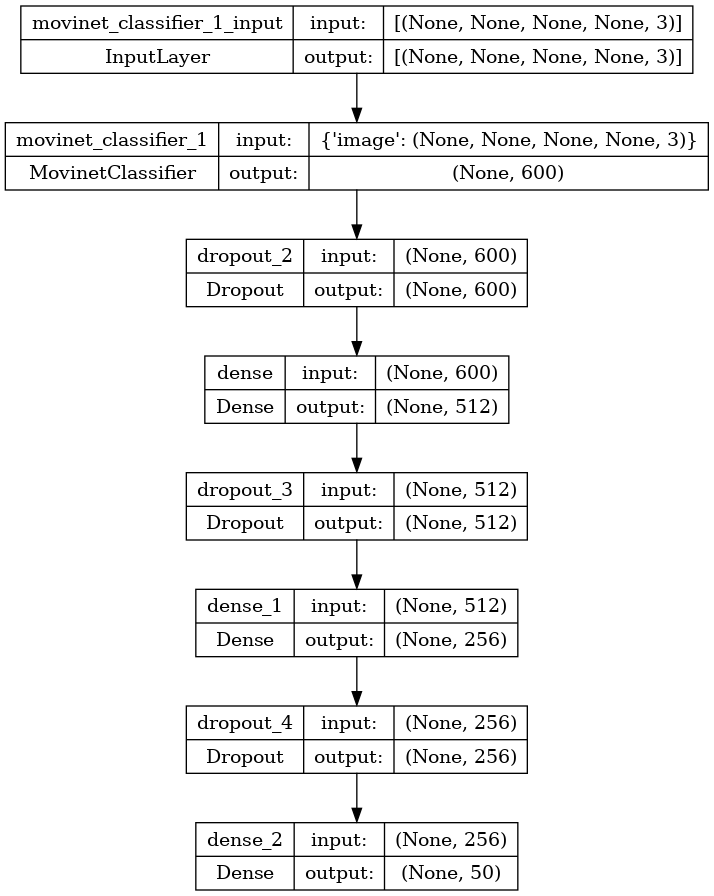

In [20]:
import tensorflow as tf
from tensorflow.keras.utils import plot_model

model.summary()
# Save the model's architecture as a PNG image
plot_model(model, to_file='model_architecture.png', show_shapes=True)


Train the model. After two epochs, observe a low loss with high accuracy for both the training and test sets.

In [21]:
train_ds, test_ds

(<_BatchDataset element_spec=(TensorSpec(shape=(None, None, None, None, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int16, name=None))>,
 <_BatchDataset element_spec=(TensorSpec(shape=(None, None, None, None, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int16, name=None))>)

In [22]:
from tensorflow.keras.callbacks import EarlyStopping

# Define the maximum number of epochs you want to run
num_epochs = 70  # You can adjust this based on your needs

# Define the early stopping callback
early_stopping = EarlyStopping(
    monitor='val_loss',  # Monitor validation loss for early stopping
    patience=8,         # Number of epochs with no improvement after which training will be stopped
    restore_best_weights=True  # Restore the best model weights based on validation loss
)

history = model.fit(train_ds,
                    validation_data=test_ds,
                    epochs=num_epochs,
                    validation_freq=1,
                    verbose=1,
                    callbacks=[early_stopping])


Epoch 1/70
84/84 [==============================] - 686s 8s/step - loss: 2.1840 - accuracy: 0.6444 - val_loss: 1.0967 - val_accuracy: 0.9018
Epoch 2/70
84/84 [==============================] - 621s 7s/step - loss: 1.0641 - accuracy: 0.9067 - val_loss: 0.9328 - val_accuracy: 0.9321
Epoch 3/70
84/84 [==============================] - 634s 8s/step - loss: 0.8920 - accuracy: 0.9326 - val_loss: 0.8239 - val_accuracy: 0.9432
Epoch 4/70
84/84 [==============================] - 634s 8s/step - loss: 0.7733 - accuracy: 0.9478 - val_loss: 0.7006 - val_accuracy: 0.9594
Epoch 5/70
84/84 [==============================] - 646s 8s/step - loss: 0.6811 - accuracy: 0.9585 - val_loss: 0.6182 - val_accuracy: 0.9668
Epoch 6/70
84/84 [==============================] - 637s 8s/step - loss: 0.6048 - accuracy: 0.9591 - val_loss: 0.5760 - val_accuracy: 0.9646
Epoch 7/70
84/84 [==============================] - 647s 8s/step - loss: 0.5327 - accuracy: 0.9692 - val_loss: 0.5224 - val_accuracy: 0.9675
Epoch 8/70
84

In [23]:
import matplotlib.pyplot as plt

# Access training history
train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

# Create subplots for accuracy and loss
plt.figure(figsize=(12, 5))

# Plot accuracy
plt.subplot(1, 2, 1)
plt.plot(train_accuracy, label='Training Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.legend()
plt.title('Accuracy Curves')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')

# Plot loss
plt.subplot(1, 2, 2)
plt.plot(train_loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend()
plt.title('Loss Curves')
plt.xlabel('Epoch')
plt.ylabel('Loss')

plt.tight_layout()  # Ensures the subplots are properly arranged
plt.savefig("Acc_Loss_Curves.jpg")
plt.show()


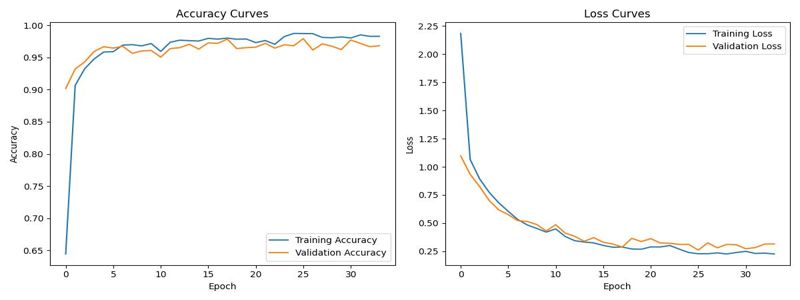

In [25]:
from PIL import Image
import IPython.display as display

# Open the image
image_path = '/kaggle/working/video_classification/Acc_Loss_Curves.jpg'  # Replace with the actual path to your image
image = Image.open(image_path)

# Define the desired output size
output_size = (800, 300)  # Replace with your desired size

# Resize the image
image_resized = image.resize(output_size)

# Display the resized image
display.display(image_resized)

## Save and load model

This block contains codes for saving and loading trained models

In [26]:
model.save('saved_model/my_model')

In [27]:
import shutil

# Specify the folder path to be downloaded
folder_path = '/kaggle/working/video_classification/saved_model'  # Replace with the actual path to your folder

# Create a zip file of the folder
shutil.make_archive('/kaggle/working/my_model', 'zip', folder_path)


'/kaggle/working/my_model.zip'

In [ ]:
# Download the zip file
from google.colab import files

files.download('/kaggle/working/my_model.zip')

In [ ]:
!unzip /content/my_model.zip -d /content/my_model

In [28]:
model = tf.keras.models.load_model('/kaggle/working/video_classification/saved_model/my_model')

# Check its architecture
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 movinet_classifier_1 (Movi  (None, 600)               3126071   
 netClassifier)                                                  
                                                                 
 dropout_2 (Dropout)         (None, 600)               0         
                                                                 
 dense (Dense)               (None, 512)               307712    
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dropout_4 (Dropout)         (None, 256)               0         
                                                        

## Evaluate the model

The model achieved high accuracy on the training dataset. Next, use Keras `Model.evaluate` to evaluate it on the test set.

In [ ]:
def plot_history(history):
  """
    Plotting training and validation learning curves.

    Args:
      history: model history with all the metric measures
  """
  fig, (ax1, ax2) = plt.subplots(2)

  fig.set_size_inches(18.5, 10.5)

  # Plot loss
  ax1.set_title('Loss')
  ax1.plot(history.history['loss'], label = 'train')
  ax1.plot(history.history['val_loss'], label = 'test')
  ax1.set_ylabel('Loss')

  # Determine upper bound of y-axis
  max_loss = max(history.history['loss'] + history.history['val_loss'])

  ax1.set_ylim([0, np.ceil(max_loss)])
  ax1.set_xlabel('Epoch')
  ax1.legend(['Train', 'Validation'])

  # Plot accuracy
  ax2.set_title('Accuracy')
  ax2.plot(history.history['accuracy'],  label = 'train')
  ax2.plot(history.history['val_accuracy'], label = 'test')
  ax2.set_ylabel('Accuracy')
  ax2.set_ylim([0, 1])
  ax2.set_xlabel('Epoch')
  ax2.legend(['Train', 'Validation'])
  plt.savefig("loss.png")
  plt.show()

plot_history(history)

In [29]:
model.evaluate(test_ds, return_dict=True)

22/22 [==============================] - 133s 6s/step - loss: 0.2713 - accuracy: 0.9779


{'loss': 0.27127790451049805, 'accuracy': 0.9778597950935364}

Confusion matrix

In [30]:
def get_actual_predicted_labels(model,dataset):
  """
    Create a list of actual ground truth values and the predictions from the model.

    Args:
      dataset: An iterable data structure, such as a TensorFlow Dataset, with features and labels.

    Return:
      Ground truth and predicted values for a particular dataset.
  """
  actual = [labels for _, labels in dataset.unbatch()]
  predicted = model.predict(dataset)

  actual = tf.stack(actual, axis=0)
  predicted = tf.concat(predicted, axis=0)
  predicted = tf.argmax(predicted, axis=1)

  return actual, predicted

In [31]:
actual, predicted = get_actual_predicted_labels(model,test_ds)

22/22 [==============================] - 131s 6s/step


In [32]:
labels = classes_1
print(labels)

['BaseballPitch', 'Basketball', 'BenchPress', 'Biking', 'Billiards', 'BreastStroke', 'CleanAndJerk', 'Diving', 'Drumming', 'Fencing', 'GolfSwing', 'HighJump', 'HorseRace', 'HorseRiding', 'HulaHoop', 'JavelinThrow', 'JugglingBalls', 'JumpRope', 'JumpingJack', 'Kayaking', 'Lunges', 'MilitaryParade', 'Mixing', 'Nunchucks', 'PizzaTossing', 'PlayingGuitar', 'PlayingPiano', 'PlayingTabla', 'PlayingViolin', 'PoleVault', 'PommelHorse', 'PullUps', 'Punch', 'PushUps', 'RockClimbingIndoor', 'RopeClimbing', 'Rowing', 'SalsaSpin', 'SkateBoarding', 'Skiing', 'Skijet', 'SoccerJuggling', 'Swing', 'TaiChi', 'TennisSwing', 'ThrowDiscus', 'TrampolineJumping', 'VolleyballSpiking', 'WalkingWithDog', 'YoYo']


In [33]:
print(actual, tf.cast(predicted, tf.int16),labels, len(labels),sep = '\n')

tf.Tensor([18 18 18 ...  7  7  7], shape=(1355,), dtype=int16)
tf.Tensor([18 18 18 ...  7  7  7], shape=(1355,), dtype=int16)
['BaseballPitch', 'Basketball', 'BenchPress', 'Biking', 'Billiards', 'BreastStroke', 'CleanAndJerk', 'Diving', 'Drumming', 'Fencing', 'GolfSwing', 'HighJump', 'HorseRace', 'HorseRiding', 'HulaHoop', 'JavelinThrow', 'JugglingBalls', 'JumpRope', 'JumpingJack', 'Kayaking', 'Lunges', 'MilitaryParade', 'Mixing', 'Nunchucks', 'PizzaTossing', 'PlayingGuitar', 'PlayingPiano', 'PlayingTabla', 'PlayingViolin', 'PoleVault', 'PommelHorse', 'PullUps', 'Punch', 'PushUps', 'RockClimbingIndoor', 'RopeClimbing', 'Rowing', 'SalsaSpin', 'SkateBoarding', 'Skiing', 'Skijet', 'SoccerJuggling', 'Swing', 'TaiChi', 'TennisSwing', 'ThrowDiscus', 'TrampolineJumping', 'VolleyballSpiking', 'WalkingWithDog', 'YoYo']
50


In [59]:
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt
import tensorflow as tf

import numpy as np

import seaborn as sns
import pandas as pd
con_mat = tf.math.confusion_matrix(labels=actual, predictions=predicted).numpy()
# con_mat_norm = np.around(con_mat.astype('float') / con_mat.sum(axis=1)[:, np.newaxis], decimals=2)

con_mat_df = pd.DataFrame(con_mat,
                     index = labels,
                     columns = labels)

figure = plt.figure(figsize=(20, 10))
custom_colors = ["#D3D3D3", "#FFA500", "#FFFF00", "#00FF00", "#8A2BE2"]  # Specify colors in hex format
# Create the custom color map from your list of colors
cmap = sns.color_palette(custom_colors, as_cmap=True)
sns.heatmap(con_mat_df, annot=True, fmt='d', cmap=cmap, cbar=False)
#sns.heatmap(con_mat_df, annot=True, fmt='d')
# sns.heatmap(con_mat_df, annot=True,cmap=plt.cm.Blues)
plt.tight_layout()
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.savefig('Confusion_martix_test.png',bbox_inches = 'tight')
plt.show()

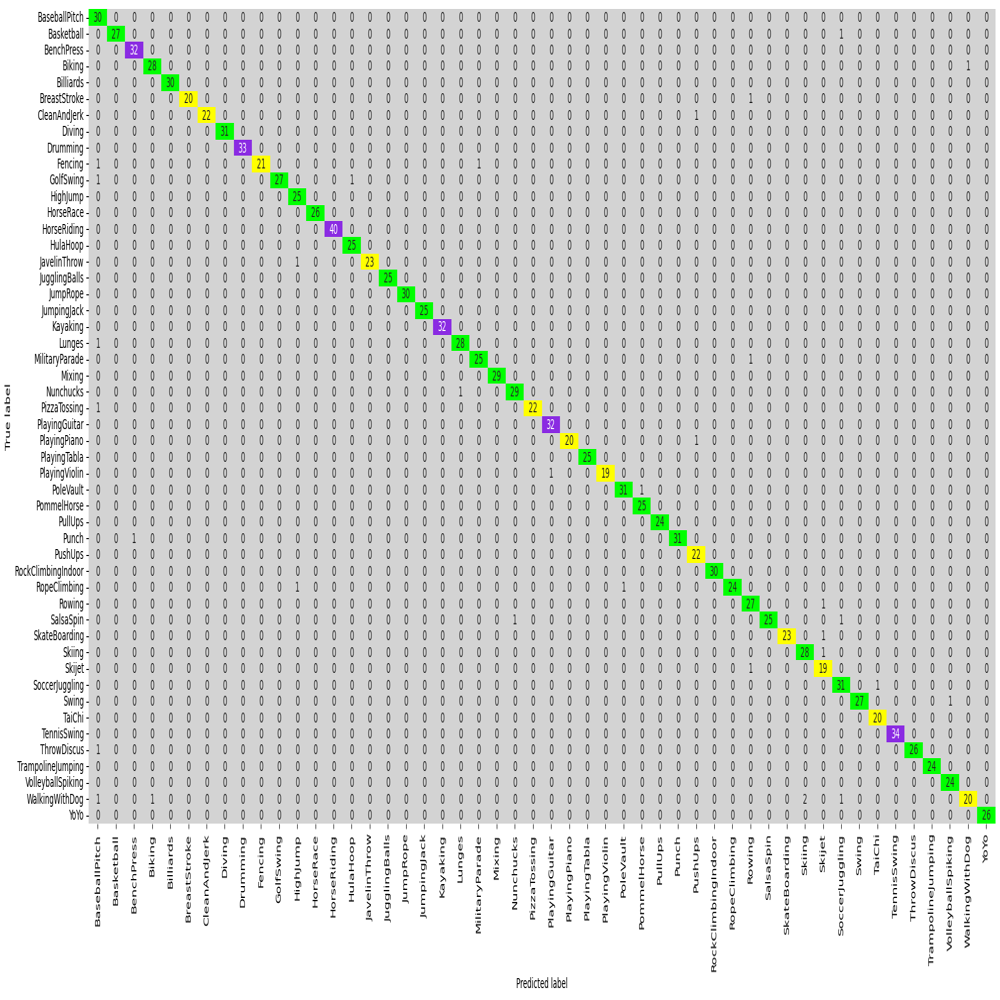

In [60]:
from PIL import Image
import IPython.display as display

# Open the image
image_path = '/kaggle/working/video_classification/Confusion_martix_test.png'  # Replace with the actual path to your image
image = Image.open(image_path)

# Define the desired output size
output_size = (1000, 1000)  # Replace with your desired size

# Resize the image
image_resized = image.resize(output_size)

# Display the resized image
display.display(image_resized)


In [62]:
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Calculate the confusion matrix
confusion_mat = confusion_matrix(actual, predicted)

# Define class labels
class_labels = classes_1  # Assuming you have defined the class names earlier

# Create a DataFrame for the confusion matrix
con_mat_df = pd.DataFrame(confusion_mat, index=class_labels, columns=class_labels)

# Calculate classification report
class_report = classification_report(actual, predicted, target_names=class_labels, output_dict=True)


# Print the classification report with precision, F1 score, and recall for all classes
class_metrics = pd.DataFrame(class_report).T
print("Classification Report:")
print(class_metrics)


Classification Report:
                    precision    recall  f1-score      support
BaseballPitch        0.833333  1.000000  0.909091    30.000000
Basketball           1.000000  0.964286  0.981818    28.000000
BenchPress           0.969697  1.000000  0.984615    32.000000
Biking               0.965517  0.965517  0.965517    29.000000
Billiards            1.000000  1.000000  1.000000    30.000000
BreastStroke         1.000000  0.952381  0.975610    21.000000
CleanAndJerk         1.000000  0.956522  0.977778    23.000000
Diving               1.000000  1.000000  1.000000    31.000000
Drumming             1.000000  1.000000  1.000000    33.000000
Fencing              1.000000  0.913043  0.954545    23.000000
GolfSwing            1.000000  0.931034  0.964286    29.000000
HighJump             0.925926  1.000000  0.961538    25.000000
HorseRace            1.000000  1.000000  1.000000    26.000000
HorseRiding          1.000000  1.000000  1.000000    40.000000
HulaHoop             0.961538  1

## Inferencing using the trained model on GIF

The same can be done on video input by following bellow method

In case of video input with shape ```(1, N*8, 244, 244, 3)``` we can split it into multiple samples with size ```( 1, 8, 244, 244, 3)``` and do the inference in a loop to obtain realtime detection results

Check what the classes are and number of classes

 The code takes a list of class labels `classes_1`, creates a list of unique classes, and generates one-hot encoded labels for each class in the original list. The resulting one-hot encoded labels are stored in the `labels_1` variable, which can be further used for tasks such as training machine learning models or performing categorical analysis.

In [63]:
import numpy as np

classes_one_hot = classes_1

# Create a list of unique classes
unique_classes = np.unique(classes_one_hot)

# Create one-hot encoded labels
labels = []
for c in classes_1:
    label = np.asarray([1 if c == cls else 0 for cls in unique_classes])
    labels.append(label)

labels_1 = np.asarray(labels)

# print(labels_1)

The provided code is designed for video inference in order to visualize the predicted output. It includes helper `load_gif`, `get_top_k` and `predict_top_k` functions that have been defined to facilitate smooth execution.

In [66]:
def load_gif(file_path, image_size=(224, 224)):
  """Loads a gif file into a TF tensor."""
  with tf.io.gfile.GFile(file_path, 'rb') as f:
    video = tf.io.decode_gif(f.read())
  video = tf.image.resize(video, image_size)
  video = tf.cast(video, tf.float32) / 255.
  return video

def get_top_k(probs, k=5, label_map=classes_1):
  """Outputs the top k model labels and probabilities on the given video."""
  top_predictions = tf.argsort(probs, axis=-1, direction='DESCENDING')[:k]
  top_labels = tf.gather(label_map, top_predictions, axis=-1)
  top_labels = [label.decode('utf8') for label in top_labels.numpy()]
  top_probs = tf.gather(probs, top_predictions, axis=-1).numpy()
  return tuple(zip(top_labels, top_probs))

def predict_top_k(model, video, k=5, label_map=classes_1):
  """Outputs the top k model labels and probabilities on the given video."""
  outputs = model.predict(video[tf.newaxis])[0]
  probs = tf.nn.softmax(outputs)
  return get_top_k(probs, k=k, label_map=label_map)

This folder is created for storing gif of the later use

In [67]:
!mkdir sample_gifs

The purpose of the code below is to traverse through all the files in the '/content/video_classification/UCF101_subset/test' directory. It randomly selects five videos from this directory for inference. Subsequently, it converts these selected videos into GIF format and saves them in the '/content/video_classification/sample_gifs' folder. The generated GIFs can be used for future inference tasks.

In [68]:
!pip install moviepy


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 388.3/388.3 kB 18.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 55.2 MB/s eta 0:00:0000:0100:01
  Created wheel for moviepy: filename=moviepy-1.0.3-py3-none-any.whl size=110730 sha256=62de0bd9af9f2f37f3603da753818e4fd989ef9e5972f06e55b7b3dd0c972c47
  Stored in directory: /root/.cache/pip/wheels/96/32/2d/e10123bd88fbfc02fed53cc18c80a171d3c87479ed845fa7c1
Successfully built moviepy
  Attempting uninstall: decorator
    Found existing installation: decorator 5.1.1
    Uninstalling decorator-5.1.1:
      Successfully uninstalled decorator-5.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2023.6.0 requires fsspec==2023.6.0, but you have fsspec 2023.9.0 which is incompatible.
jupyterlab-lsp 4.2.0 requires jupyter-lsp>=2.0.0, but you have jupy

In [71]:
import os
import random
from moviepy.editor import VideoFileClip

# Specify the directory path
directory = '/kaggle/working/video_classification/UCF_50_Split/val'
save_dir = '/kaggle/working/video_classification/sample_gifs'

# Get a list of subdirectories within the main directory
subdirectories = [subdir for subdir in os.listdir(directory) if os.path.isdir(os.path.join(directory, subdir))]


for i in range(5):
    subdir = random.choice(subdirectories)
    # Iterate over each subdirectory
    # for subdir in subdirectories:
    subdir_path = os.path.join(directory, subdir)
    # Get a list of files within the subdirectory with the .avi extension
    files = [file for file in os.listdir(subdir_path) if file.endswith('.avi')]

    # Randomly select a file from the files list
    random_file = random.choice(files)

    # Print the selected file
    print("Random .avi file from", subdir, ":", random_file)
    input = directory+'/'+subdir+'/'+random_file
    clip = VideoFileClip(input)
    output = save_dir+'/'+random_file.split('.')[0]+'.gif'
    print(output)
    clip.write_gif(output)


Random .avi file from HulaHoop : v_HulaHoop_g01_c05.avi
/kaggle/working/video_classification/sample_gifs/v_HulaHoop_g01_c05.gif
MoviePy - Building file /kaggle/working/video_classification/sample_gifs/v_HulaHoop_g01_c05.gif with imageio.


Random .avi file from PlayingTabla : v_PlayingTabla_g07_c03.avi
/kaggle/working/video_classification/sample_gifs/v_PlayingTabla_g07_c03.gif
MoviePy - Building file /kaggle/working/video_classification/sample_gifs/v_PlayingTabla_g07_c03.gif with imageio.


Random .avi file from JugglingBalls : v_JugglingBalls_g06_c02.avi
/kaggle/working/video_classification/sample_gifs/v_JugglingBalls_g06_c02.gif
MoviePy - Building file /kaggle/working/video_classification/sample_gifs/v_JugglingBalls_g06_c02.gif with imageio.


Random .avi file from JumpRope : v_JumpRope_g11_c02.avi
/kaggle/working/video_classification/sample_gifs/v_JumpRope_g11_c02.gif
MoviePy - Building file /kaggle/working/video_classification/sample_gifs/v_JumpRope_g11_c02.gif with imageio.


Random .avi file from PlayingGuitar : v_PlayingGuitar_g02_c03.avi
/kaggle/working/video_classification/sample_gifs/v_PlayingGuitar_g02_c03.gif
MoviePy - Building file /kaggle/working/video_classification/sample_gifs/v_PlayingGuitar_g02_c03.gif with imageio.



The provided code iterates through all the files in the '/content/video_classification/sample_gifs' directory. It utilizes these files for video classification and presents the output in the form of a GIF and displays the top five predictions associated with the video classification task.

In [72]:
save_dir = '/kaggle/working/video_classification/sample_gifs'
files = [file for file in os.listdir(save_dir) if file.endswith('.gif')]
for file_name in files:
  file_name = save_dir+'/'+file_name
  video = load_gif(file_name, image_size=(244, 244))
  media.show_video(video.numpy(), fps=23)
  outputs = predict_top_k(model, video)
  for label, prob in outputs:
    print(label, prob)

1/1 [==============================] - 0s 266ms/step
PizzaTossing 0.027227757
SoccerJuggling 0.02595082
SalsaSpin 0.02459014
Nunchucks 0.021631788
WalkingWithDog 0.019797679


1/1 [==============================] - 12s 12s/step
PlayingTabla 0.05233765
PlayingGuitar 0.01942199
PlayingPiano 0.019339101
Rowing 0.019338515
JugglingBalls 0.019338345


1/1 [==============================] - 0s 203ms/step
Mixing 0.052553553
ThrowDiscus 0.019336533
BaseballPitch 0.019336514
HorseRace 0.019335875
PizzaTossing 0.019335628


1/1 [==============================] - 0s 375ms/step
Skijet 0.052099664
Rowing 0.019434461
Diving 0.019422214
PlayingPiano 0.019342285
Kayaking 0.019341746


1/1 [==============================] - 11s 11s/step
JugglingBalls 0.04045869
SoccerJuggling 0.025411924
PizzaTossing 0.019472286
PlayingTabla 0.019464163
YoYo 0.019463595


1/1 [==============================] - 0s 133ms/step
PoleVault 0.02829826
TennisSwing 0.022715352
PlayingTabla 0.02174284
TaiChi 0.021225227
GolfSwing 0.021157252


1/1 [==============================] - 12s 12s/step
PlayingGuitar 0.052559394
BaseballPitch 0.019335523
Basketball 0.019335523
BenchPress 0.019335523
Biking 0.019335523


1/1 [==============================] - 18s 18s/step
JumpRope 0.05255066
TaiChi 0.019336808
TennisSwing 0.019336648
SoccerJuggling 0.019336088
Lunges 0.019335812


1/1 [==============================] - 9s 9s/step
HulaHoop 0.052559163
PlayingViolin 0.019335594
BenchPress 0.019335538
Kayaking 0.01933553
GolfSwing 0.019335529


1/1 [==============================] - 0s 458ms/step
Punch 0.05255938
Billiards 0.019335527
PizzaTossing 0.019335527
BaseballPitch 0.019335523
Basketball 0.019335523


In [73]:
save_dir = '/kaggle/working/video_classification/sample_gifs'
files = [file for file in os.listdir(save_dir) if file.endswith('.gif')]
for file_name in files:
  file_name = save_dir+'/'+file_name
  video = load_gif(file_name, image_size=(244, 244))
  media.show_video(video.numpy(), fps=23)
  outputs = predict_top_k(model, video)
  for label, prob in outputs:
    print(label, prob)

1/1 [==============================] - 0s 261ms/step
PizzaTossing 0.027227757
SoccerJuggling 0.02595082
SalsaSpin 0.02459014
Nunchucks 0.021631788
WalkingWithDog 0.019797679


1/1 [==============================] - 0s 429ms/step
PlayingTabla 0.05233765
PlayingGuitar 0.01942199
PlayingPiano 0.019339101
Rowing 0.019338515
JugglingBalls 0.019338345


1/1 [==============================] - 0s 204ms/step
Mixing 0.052553553
ThrowDiscus 0.019336533
BaseballPitch 0.019336514
HorseRace 0.019335875
PizzaTossing 0.019335628


1/1 [==============================] - 0s 370ms/step
Skijet 0.052099664
Rowing 0.019434461
Diving 0.019422214
PlayingPiano 0.019342285
Kayaking 0.019341746


1/1 [==============================] - 0s 354ms/step
JugglingBalls 0.04045869
SoccerJuggling 0.025411924
PizzaTossing 0.019472286
PlayingTabla 0.019464163
YoYo 0.019463595


1/1 [==============================] - 0s 130ms/step
PoleVault 0.02829826
TennisSwing 0.022715352
PlayingTabla 0.02174284
TaiChi 0.021225227
GolfSwing 0.021157252


1/1 [==============================] - 0s 367ms/step
PlayingGuitar 0.052559394
BaseballPitch 0.019335523
Basketball 0.019335523
BenchPress 0.019335523
Biking 0.019335523


1/1 [==============================] - 1s 739ms/step
JumpRope 0.05255066
TaiChi 0.019336808
TennisSwing 0.019336648
SoccerJuggling 0.019336088
Lunges 0.019335812


1/1 [==============================] - 0s 196ms/step
HulaHoop 0.052559163
PlayingViolin 0.019335594
BenchPress 0.019335538
Kayaking 0.01933553
GolfSwing 0.019335529


1/1 [==============================] - 0s 434ms/step
Punch 0.05255938
Billiards 0.019335527
PizzaTossing 0.019335527
BaseballPitch 0.019335523
Basketball 0.019335523


In [ ]:
'''
import os

working_dir = '/kaggle/working/'  # This is the path to your Kaggle working directory

# List all files and directories in the working directory
files = os.listdir(working_dir)

# Delete all files in the working directory
for file in files:
    file_path = os.path.join(working_dir, file)
    if os.path.isfile(file_path):
        os.remove(file_path)
'''

In [1]:
import shutil

# Define the directory path you want to remove
directory_to_remove = '/kaggle/working/'

# Use shutil.rmtree to remove the directory and its contents
shutil.rmtree(directory_to_remove)


OSError: [Errno 16] Device or resource busy: '/kaggle/working/'